In [1]:
import time
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F
import math

In [2]:
# set seed for reproducibility
SEED = 1732466
np.random.seed(SEED)
torch.manual_seed(SEED)

# torch.autograd.set_detect_anomaly(True)

# Part I: Implementations

In [3]:
class KoopmanModel(nn.Module):
    
    def __init__(self, input_dim, autoencoder_layers, num_efunction):
        super(KoopmanModel, self).__init__()
        self.input_dim = input_dim
        self.autoencoder_layers = autoencoder_layers
        self.num_efunction = num_efunction
        self.relu = nn.ReLU()

        self.encoder_layers = nn.ModuleList([])
        self.encoder_layers.append(nn.Linear(input_dim, autoencoder_layers[0]))
        for i in range(1, len(autoencoder_layers)):
            self.encoder_layers.append(nn.Linear(autoencoder_layers[i-1], autoencoder_layers[i]))
        self.encoder_layers.append(nn.Linear(autoencoder_layers[-1], num_efunction))

        self.koopman_forward_layer = nn.Linear(num_efunction, num_efunction, bias=False)

        self.decoder_layers = nn.ModuleList([])
        self.decoder_layers.append(nn.Linear(num_efunction, autoencoder_layers[-1]))
        for i in range(len(autoencoder_layers)-1, 0, -1):
            self.decoder_layers.append(nn.Linear(autoencoder_layers[i], autoencoder_layers[i-1]))
        self.decoder_layers.append(nn.Linear(autoencoder_layers[0], input_dim))
    
    def encoder(self, inputs):
        for i in range(len(self.encoder_layers)-1):
            inputs = self.encoder_layers[i](inputs)
            inputs = self.relu(inputs)
        return self.encoder_layers[-1](inputs)

    def linear_koopman_forward(self, inputs):
        gx_next = self.koopman_forward_layer(inputs)
        return gx_next
    
    def decoder(self, inputs):
        for i in range(len(self.decoder_layers)-1):
            inputs = self.decoder_layers[i](inputs)
            inputs = self.relu(inputs)
        return self.decoder_layers[-1](inputs)

    def forward(self, inputs):
        batch_size = inputs.shape[0]
        gx = self.encoder(inputs)
        x_auto = self.decoder(gx)
        gx1 = gx[0,:]
        gx_pred = torch.zeros((batch_size-1, self.num_efunction))
        gx_pred[0,:] = self.linear_koopman_forward(gx1)
        for i in range(1, batch_size-1):
            gx_pred[i,:] = self.linear_koopman_forward(gx_pred[i-1,:].clone())
        x_pred = self.decoder(gx_pred)
        return gx, gx_pred, x_pred, x_auto

In [4]:
def loading_data(batch_size, train_set, shuffle=True):
    """
    Create the dataloader for training and test set.
    :param batch_size: Batch size when creating the trainloader.
    :param train_set: Training set.
    :param test_set: Test set.
    :param shuffle: Boolean of whether shuffle argument will be activated for creating the trainloader

    :return trainloader: Dataloader for the training set.
    :return testloader: Dataloader for the test set and it only contains one zip of element.
    """

    num, dim = train_set.shape
    train_num = int(num * 0.8)
    test_num = num - train_num
    train = train_set[:train_num,:]
    test = train_set[train_num:,:]
    stack_train_set = np.zeros(((train_num-batch_size+1)*batch_size,dim))
    stack_test_set = np.zeros(((test_num-batch_size+1)*batch_size,dim))
    for i in range(train_num-batch_size+1):
        stack_train_set[i*batch_size:(i+1)*batch_size] = train[i:i+batch_size]
    trainloader = torch.utils.data.DataLoader(stack_train_set, batch_size=batch_size, shuffle=False)
    for i in range(test_num-batch_size+1):
        stack_test_set[i*batch_size:(i+1)*batch_size] = test[i:i+batch_size]
    testloader = torch.utils.data.DataLoader(stack_test_set, batch_size=batch_size, shuffle=False)

    return trainloader, testloader

In [5]:
def variance_loss(gx, rate, dim):
    variance_loss = 0.0
    check_dim = int(dim*rate) * 2
    check_dim_index = np.random.choice(np.arange(dim), size=check_dim, replace=False)
    check_pairs = check_dim_index.reshape(-1,2)
    for pair in check_pairs:
        variance_loss -= torch.mean((gx[pair[0],:] - gx[pair[1],:])**2)
    return variance_loss / int(dim*rate)

def abs_loss(gx, rate, dim):
    abs_loss = 0.0
    check_dim = int(dim*rate)
    check_dim_index = np.random.choice(np.arange(dim), size=check_dim, replace=False)
    for index in check_dim_index:
        abs_loss -= torch.max(gx[index,:]) - torch.min(gx[index,:])
    return abs_loss / int(dim*rate)

def loss(x, gx, gx_pred, x_pred, x_auto, coef, check_rate=0.1):
    dim = gx.shape[0]
    auto_loss = F.mse_loss(x[0,:], x_auto[0,:], reduction='sum') #/ x.shape[0]
    pred_loss = F.mse_loss(x[1:,:], x_pred, reduction='sum') / x_pred.shape[0]
    gx_pred_loss = F.mse_loss(gx[1:,:], gx_pred, reduction='sum') / gx_pred.shape[0]
    gx_variance_loss = variance_loss(gx, check_rate, dim)
    gx_abs_loss = abs_loss(gx, check_rate, dim)
    loss = coef[0] * auto_loss + coef[1] * pred_loss + coef[2] * gx_pred_loss + coef[3] * gx_variance_loss + coef[4] * gx_abs_loss
    return loss

def train_epoch(trainloader, net, optimizer, coef):
    """
    Train the net for one epoch.
    :param trainloader: Dataloader for the training set.
    :param net: The NN model.
    :param optimizer: The optimisation algorithm used for the backpropagation.
    :param criterion: The loss function used to train the model.

    :return total_loss: The training loss of this epoch.
    """

    total_loss = 0
    for batch in trainloader:
        # get training features and labels in current batch
        x = batch.to(torch.float32)
        # 1. get predictions
        gx, gx_pred, x_pred, x_auto = net(x)
        # 2. compute loss
        loss_value = loss(x, gx, gx_pred, x_pred, x_auto, coef)
        # 3. back propagation
        optimizer.zero_grad() # reset grads to zero
        loss_value.backward() # calculates gradients 
        optimizer.step() # update parameters
        total_loss += loss_value.item()

    return total_loss

### Task 4

In [6]:
def test_epoch(testloader, net, coef):
    """
    Test the net for one epoch.
    :param testloader: Dataloader for the test set.
    :param net: The NN model.
    :param criterion: The loss function used to test the model.

    :return loss: The average test loss of this epoch.
    :return err: The error of this epoch.
    """

    with torch.no_grad():
        total_loss = 0
        for batch in testloader:
            x = batch.to(torch.float32)
            gx, gx_pred, x_pred, x_auto = net(x)
            loss_value = loss(x, gx, gx_pred, x_pred, x_auto, coef)
            total_loss += loss_value.item()

    return total_loss

In [7]:
def train_test(model, train_set, batch_size, coef, lr=0.01, nepochs=1, set_optimizer=torch.optim.SGD):
    """
    Train a model and evaluate loss and accuracy at each epoch
    for both training and test dataset.

    :param train_set: The training set for training the parameters of the model.
    :param test_set: The test set for evaluating the model.
    :param batch_size: Batch size when creating the dataloader.
    :param dim: The dimension of the flattened input of the model.
    :param nclass: The number of output classes of the model.
    :param width: The width in each hidden layer of the model.
    :param depth: The depth of the model.
    :param lr: The learning rate of the optimizer.
    :param nepochs: Number of training epochs.
    :param criterion: The loss function used to train the model.
    :param optimizer: The optimisation algorithm used for the backpropagation.
    :param tolerence: The tolerence for another stopping criterion for the model.

    :return train_loss_list: The list of all training loss over all epochs.
    :return test_loss_list: The list of all test loss over all epochs.
    :return test_err_list: The list of all test error over all epochs.
    """

    # initialization
    trainloader, testloader = loading_data(batch_size, train_set)
    optimizer = set_optimizer(model.parameters(), lr=lr, momentum=0.9, weight_decay=coef[-1])

    train_epoch_losses = []
    test_epoch_losses = []
    for epoch in range(1, nepochs+1):
        train_loss = train_epoch(trainloader, model, optimizer, coef)
        train_epoch_losses.append(train_loss)
        # print('train epoch{} loss'.format(epoch), train_loss)
        test_loss = test_epoch(testloader, model, coef)
        test_epoch_losses.append(test_loss)
        # print('test epoch{} loss'.format(epoch), test_loss)
        
    return train_epoch_losses, test_epoch_losses

# Part II: Train

random Arnold circle map

0.7889759893957821


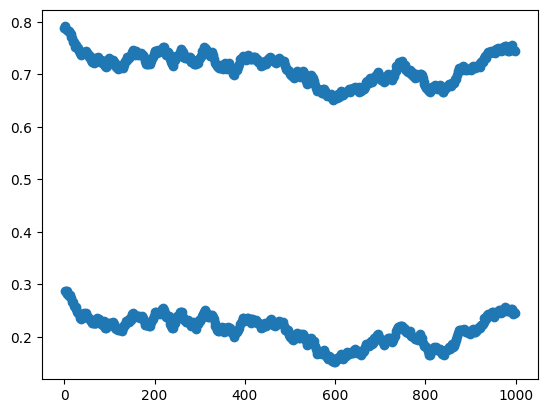

In [8]:
def noisy_rotation(x, v, omega, n, delta, center=None):
    if omega:
        np.random.seed(omega)
    omegas = np.random.uniform(-delta/2, delta/2, n-1)
    traj = np.zeros(n)
    traj[0] = x
    for i in range(1, n):
        traj[i] = (traj[i-1] + v + omegas[i-1] + np.sin(2*np.pi*traj[-1]/2*np.pi)) % 1
    if center:
        traj -= (traj>center)
    return traj

x = np.random.rand()
print(x)
v = 1/2
omega = 10
n = 1000
delta = 0.01
traj = noisy_rotation(x, v, None, n, delta)
plt.scatter(np.arange(n), traj)

taking the observable to be x^4

In [9]:
def get_f(degree):
    def f(traj):
        return traj ** degree
    return f

def gen_noisy_rotatation_expectation(f, x, v, n, delta, num=1000):
    f_trajs = np.zeros((num, n))
    for i in range(num):
        traj = noisy_rotation(x, v, None, n, delta)
        f_traj = f(traj)
        f_trajs[i,:] = f_traj
    return np.mean(f_trajs, axis=0)

x = np.random.rand()
v = 1/2
n = 1000
delta = 0.01
degrees = [1, 4]
traj_expectation_degrees = []
for degree in degrees:
    traj_expectation_degrees.append(gen_noisy_rotatation_expectation(get_f(degree), x, v, n, delta))
# len(traj_expectation_degrees)

extend to subspace of dimension 256

In [10]:
def gen_autoencoder_layers_list(num_efunction_list):
    autoencoder_layers_list = {}
    for num_efunction in num_efunction_list:
        layers1 = [num_efunction, num_efunction]
        layers2 = [num_efunction//4, num_efunction//2, num_efunction, num_efunction]
        layers3 = [num_efunction//2, num_efunction, num_efunction*2, num_efunction]
        autoencoder_layers_list[num_efunction] = [layers1, layers2, layers3]
    return autoencoder_layers_list

def gen_coef_list(list1, list2, list3, list4):
    coef_list = []
    for i1 in list1:
        for i2 in list2:
            for i3 in list3:
                for i4 in list4:
                    coef_list.append([i1, i1, i2, i3, i3, i4])
    return coef_list

input_dim = 1
num_efunction_list = [64, 128]
memory_steps_list = [16, 32]
coef_list = gen_coef_list([0.1, 0.8], [1], [0.01, 0.001], [1.0e-10])
autoencoder_layers_list = gen_autoencoder_layers_list(num_efunction_list)
lrs = [0.01, 0.001]
models = {}
total_loss = {}

count = 0 #total 192
for num_efunction in num_efunction_list: #2
    for memory_steps in memory_steps_list: #2
        for autoencoder_layers in autoencoder_layers_list[num_efunction]: #3
            for coef in coef_list: #4
                for lr in lrs: #2
                    for traj_expectation, degree in zip(traj_expectation_degrees, degrees): #2
                        count += 1
                        print(count)
                        label = str([num_efunction, memory_steps, autoencoder_layers, coef, lr, degree])
                        models[label] = KoopmanModel(input_dim, autoencoder_layers, num_efunction)
                        total_loss[label] = train_test(
                                            models[label], 
                                            traj_expectation.reshape(-1,input_dim), 
                                            memory_steps, 
                                            coef, 
                                            nepochs=20, 
                                            lr=lr)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192


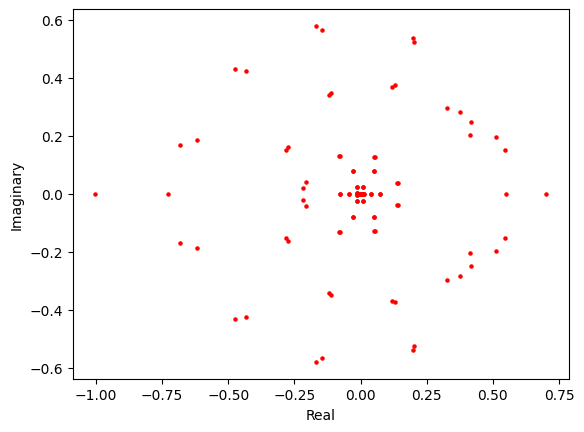

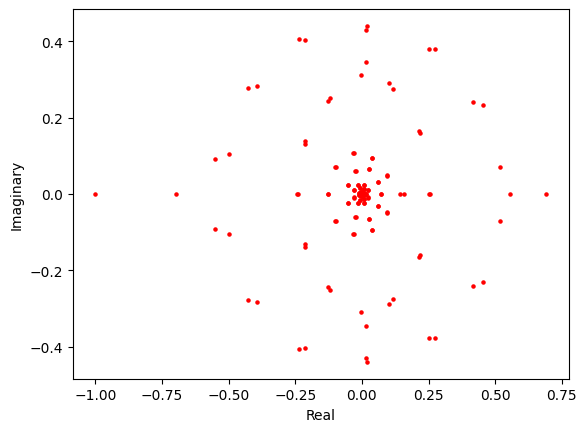

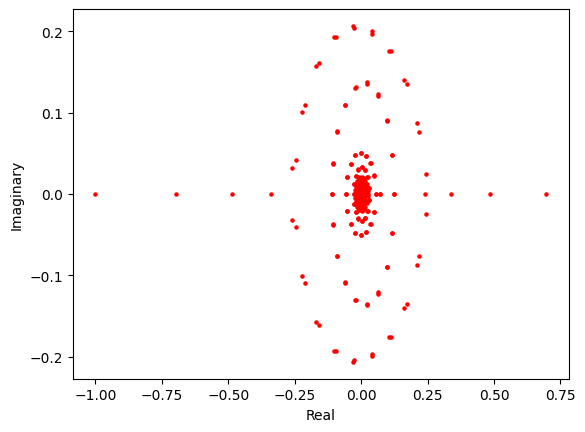

In [11]:
from cmath import exp, pi, sin as exp, pi, sin
from scipy.special import jv
import cmath

def eval_approx(N, K, delta, v):
    A = np.zeros((2*N+1, 2*N+1),dtype='complex')
    for i in np.arange(-N,N+1,1):
        for j in np.arange(-N,N+1,1):
            if j == 0:
                A[i,j] = delta*cmath.exp(2*cmath.pi*(0+1j)*j*v)*jv(j-i, j*K)
            else:
                A[i,j] = cmath.sin(cmath.pi*delta*j)/(delta*cmath.pi*j)*cmath.exp(2*cmath.pi*(0+1j)*j*v)*jv(j-i, j*K)
    w, v = np.linalg.eig(A)
    return w, v, A

delta = 0.01
N = 64
K = 1
v = 1/2
w, v, A = eval_approx(N, K, delta, v)
real_eval_complex = {}
real_eval_complex[64] = w
trueevalues = {}

# extract real part
re = [ele.real for ele in w]
# extract imaginary part
im = [ele.imag for ele in w]
trueevalues[64] = [re, im]

# plot the complex numbers
plt.figure()
plt.scatter(re, im, s=5, c='red')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

delta = 0.01
N = 128
K = 1
v = 1/2
w, v, A = eval_approx(N, K, delta, v)
real_eval_complex[128] = w

# extract real part
re = [ele.real for ele in w]
# extract imaginary part
im = [ele.imag for ele in w]
trueevalues[128] = [re, im]

# plot the complex numbers
plt.figure()
plt.scatter(re, im, s=5, c='red')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

delta = 0.01
N = 1024
K = 1
v = 1/2
w, v, A = eval_approx(N, K, delta, v)
real_eval_complex[128] = w

# extract real part
re = [ele.real for ele in w]
# extract imaginary part
im = [ele.imag for ele in w]

# plot the complex numbers
plt.figure()
plt.scatter(re, im, s=5, c='red')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

c:\Users\sunsh\AppData\Local\Programs\Python\Python310\lib\site-packages\matplotlib\cbook\__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


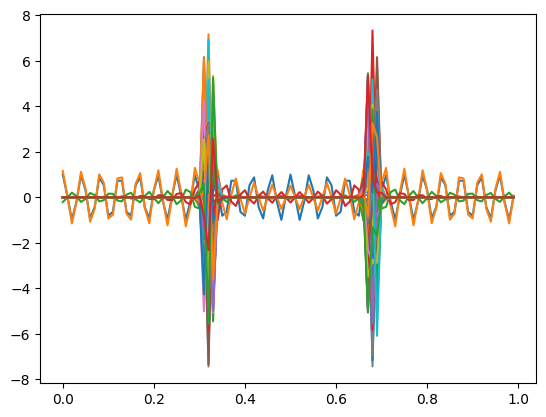

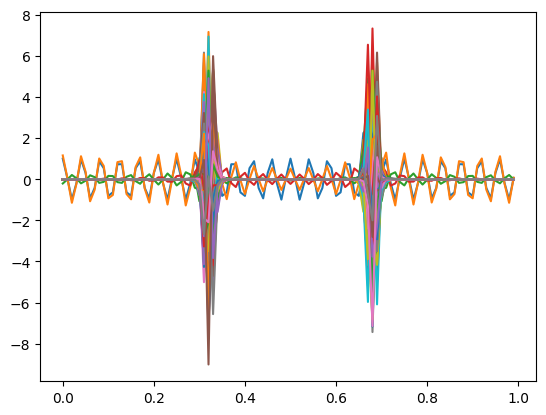

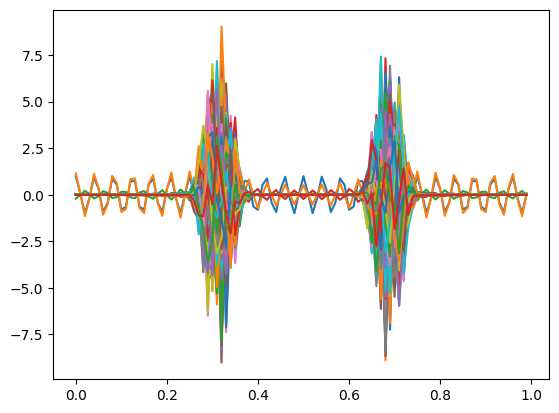

In [12]:
def get_efunction(c, N):
    def efunction(x):
        fx = np.zeros(len(x),dtype='complex')
        for i in np.arange(-N,N+1,1):
            fx += c[i+N] * np.exp(2*np.pi*(0+1j)*i*x)
        return fx
    return efunction

N = int((v.shape[0] - 1)/2)
x = np.arange(100,dtype='float32')/100
no = 64
plt.figure()
for i in range(np.min([v.shape[0],no])):
    fx = get_efunction(v[:,i], N)(x)
    # print(fx)
    if i % 1==0:
        plt.plot(x,fx)

N = int((v.shape[0] - 1)/2)
x = np.arange(100,dtype='float32')/100
no = 128
plt.figure()
for i in range(np.min([v.shape[0],no])):
    fx = get_efunction(v[:,i], N)(x)
    if i % 1==0:
        plt.plot(x,fx)

N = int((v.shape[0] - 1)/2)
x = np.arange(100,dtype='float32')/100
no = 1024
plt.figure()
for i in range(np.min([v.shape[0],no])):
    fx = get_efunction(v[:,i], N)(x)
    if i % 1==0:
        plt.plot(x,fx)

C:\Users\sunsh\AppData\Local\Temp\ipykernel_23288\1462471705.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


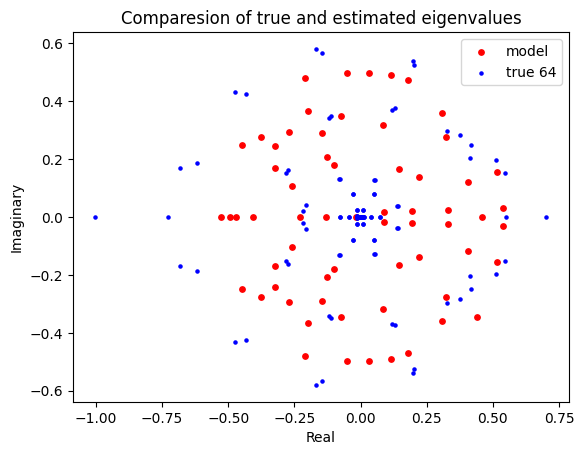

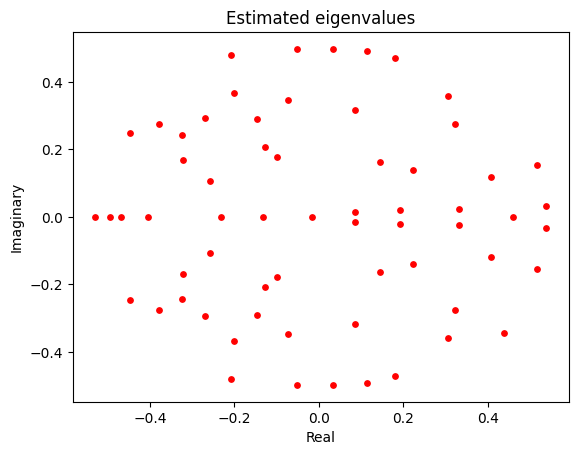

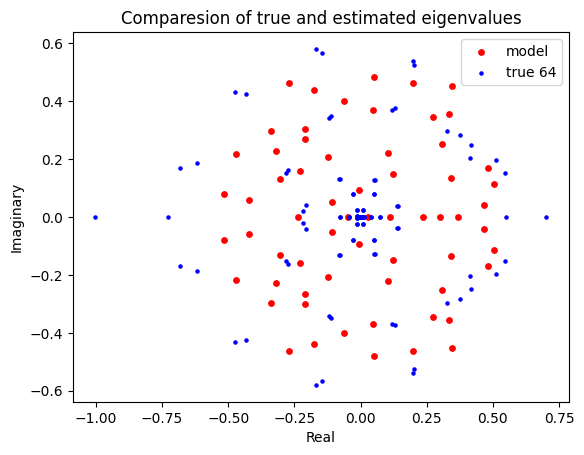

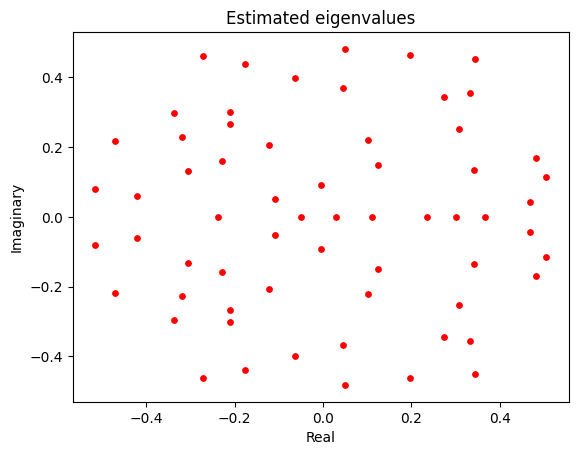

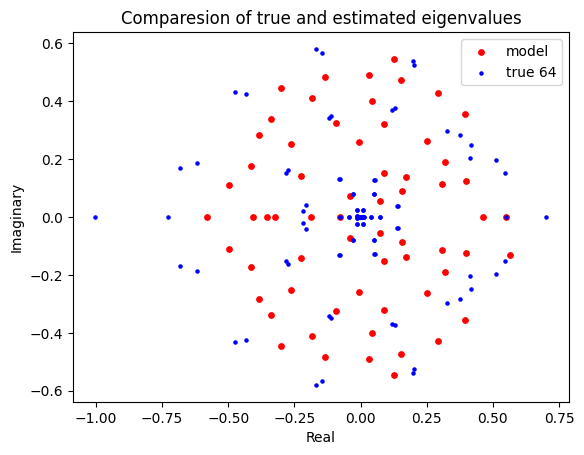

...

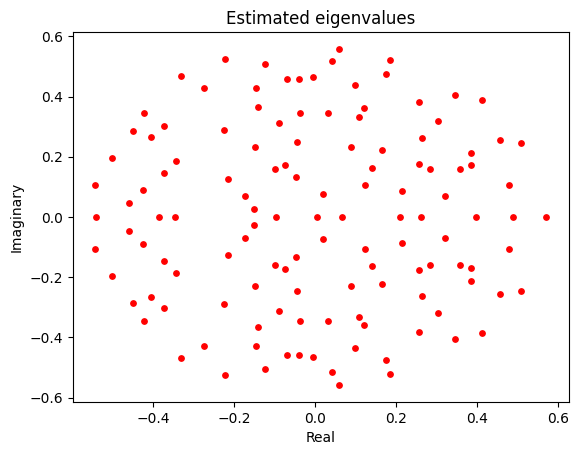

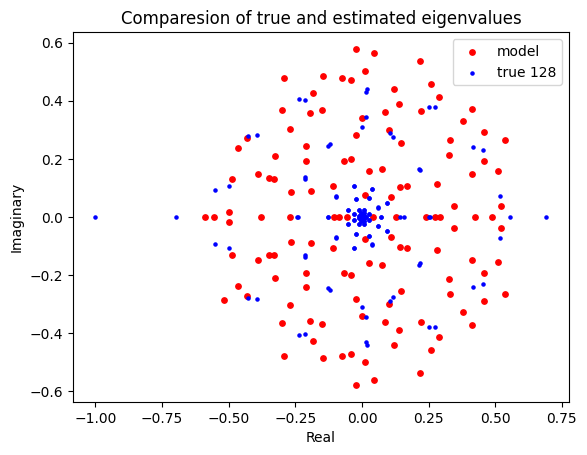

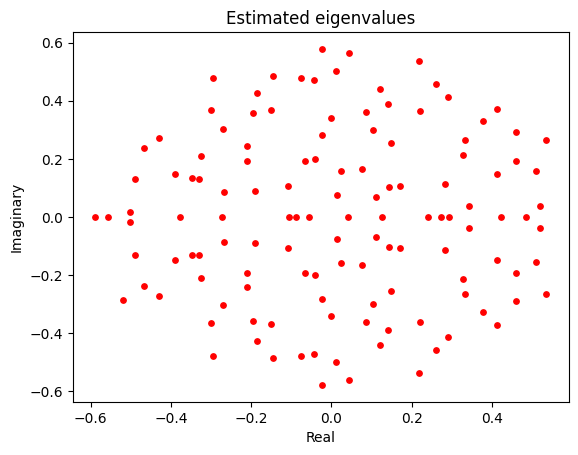

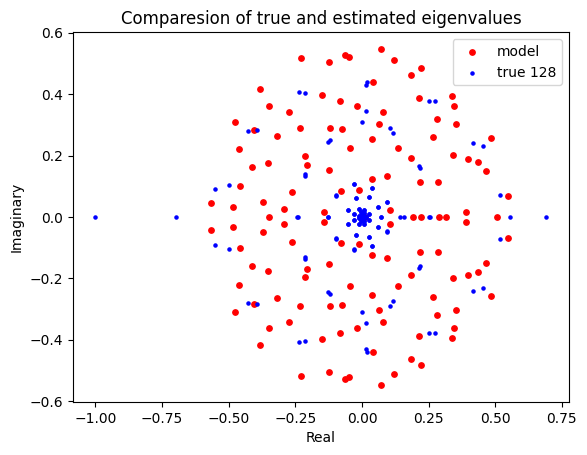

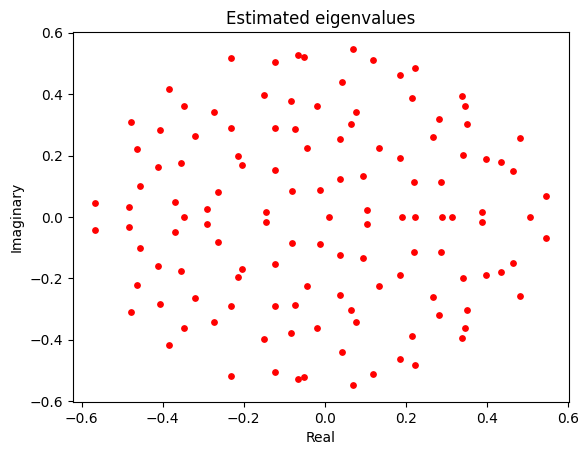

In [19]:
eigvals = {}
for num_efunction in num_efunction_list: #2
    for memory_steps in memory_steps_list: #2
        for autoencoder_layers in autoencoder_layers_list[num_efunction]: #3
            for coef in coef_list: #4
                for lr in lrs: #2
                    for traj_expectation, degree in zip(traj_expectation_degrees, degrees): #2
                        label = str([num_efunction, memory_steps, autoencoder_layers, coef, lr, degree])
                        model = models[label]
                        try:
                            for i in model.koopman_forward_layer.parameters():
                                a = i
                                b = a.detach().numpy()
                                eigvals[label] = np.linalg.eigvals(b)

                                # extract real part
                                re = [ele.real for ele in eigvals[label]]
                                # extract imaginary part
                                im = [ele.imag for ele in eigvals[label]]

                                # plot the complex numbers
                                plt.figure()
                                plt.scatter(re[1:], im[1:], s=15, c='red', label='model')
                                plt.scatter(trueevalues[num_efunction][0], trueevalues[num_efunction][1], s=5, c='blue', label='true {}'.format(num_efunction))
                                plt.ylabel('Imaginary')
                                plt.xlabel('Real')
                                title = 'eigenfunction={}, memory_steps={}, model structure={}, weights={}, lr={}, observable degree={}'.format(num_efunction, memory_steps, autoencoder_layers, coef, lr, degree)
                                title = title.replace(" ", "")
                                plt.title('Comparesion of true and estimated eigenvalues')
                                plt.legend()
                                plt.savefig('compared_' + title + '.png')
                                # plt.show()

                                plt.figure()
                                plt.scatter(re[1:], im[1:], s=15, c='red', label='model')
                                plt.ylabel('Imaginary')
                                plt.xlabel('Real')
                                plt.title('Estimated eigenvalues')
                                plt.savefig('estimateonly_' + title + '.png')
                                # plt.show()
                        except Exception:
                            continue

C:\Users\sunsh\AppData\Local\Temp\ipykernel_23288\1674968004.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


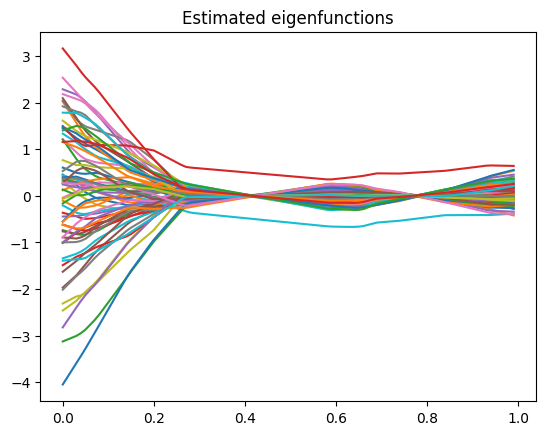

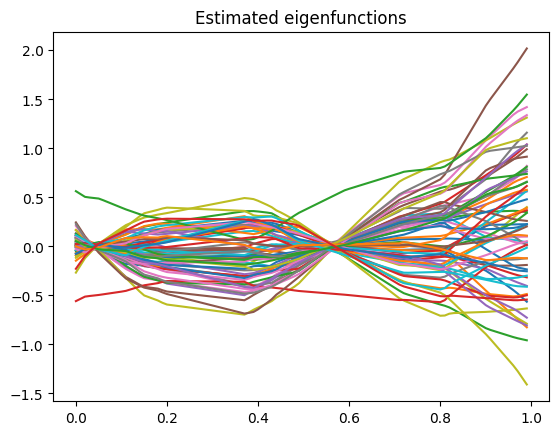

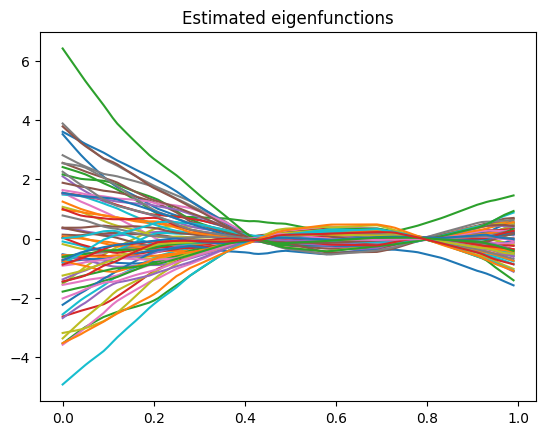

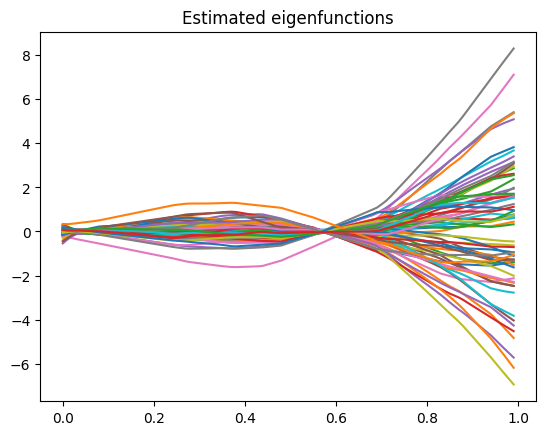

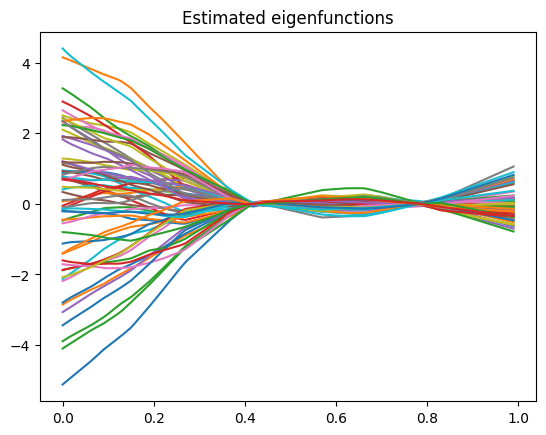

...

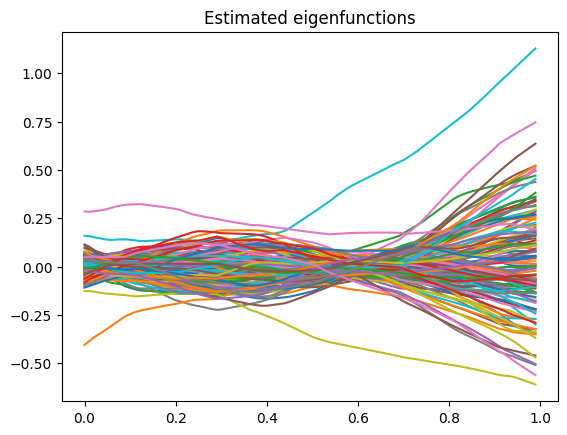

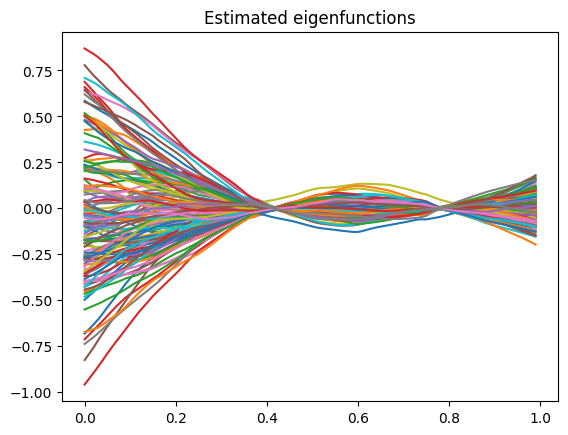

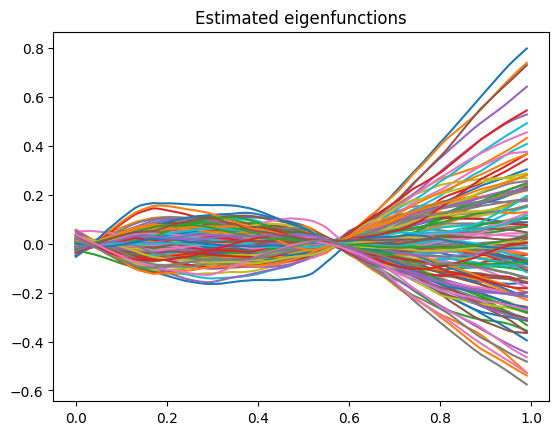

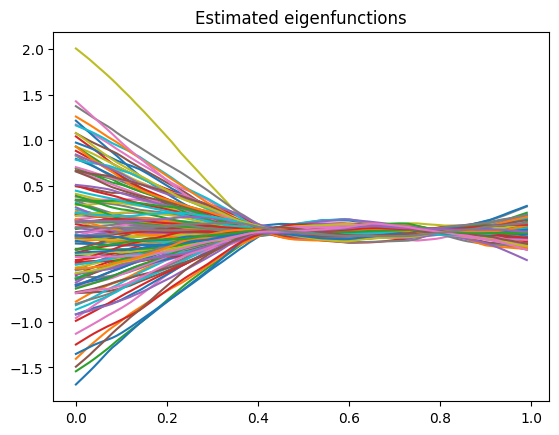

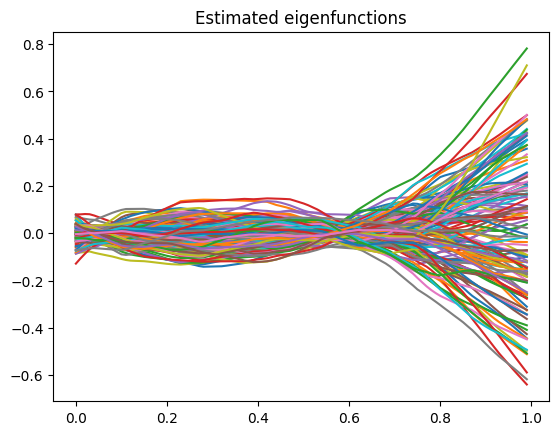

In [15]:
for num_efunction in num_efunction_list: #2
    for memory_steps in memory_steps_list: #2
        for autoencoder_layers in autoencoder_layers_list[num_efunction]: #3
            for coef in coef_list: #4
                for lr in lrs: #2
                    for traj_expectation, degree in zip(traj_expectation_degrees, degrees): #2
                        try:
                            label = str([num_efunction, memory_steps, autoencoder_layers, coef, lr, degree])
                            model = models[label]
                            plt.figure()
                            with torch.no_grad():
                                x = np.arange(100,dtype='float32')/100
                                x = x.reshape(-1,1)
                                x = torch.tensor(x)
                                gx, gx_pred, x_pred, x_auto = model(x)
                                gx = gx.detach().numpy()
                                x = x.detach().numpy()
                                for i in range(num_efunction):
                                    plt.plot(x,gx[:,i]*100)
                                plt.title('Estimated eigenfunctions')
                                title = 'eigenfunction={}, memory_steps={}, model structure={}, weights={}, lr={}, observable degree={}'.format(num_efunction, memory_steps, autoencoder_layers, coef, lr, degree)
                                title = title.replace(" ", "")
                                plt.savefig('efunction_' + title + '.png')
                        except Exception:
                            continue

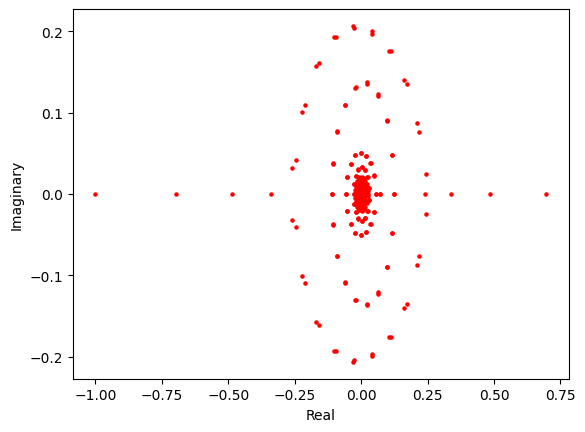

In [20]:
def avg_distance(arr1, arr2):

    distances = np.empty(len(arr1))
    for i, point1 in enumerate(arr1):
        point_distances = np.abs(arr2 - point1)
        min_distance = np.min(point_distances)
        distances[i] = min_distance

    # Calculate the average distance
    average_distance = np.mean(distances)
    return average_distance

delta = 0.01
N = 1024
K = 1
v = 1/2
w, v, A = eval_approx(N, K, delta, v)
real_eval_complex[1024] = w

# extract real part
re = [ele.real for ele in w]
# extract imaginary part
im = [ele.imag for ele in w]
trueevalues[1024] = [re, im]

# plot the complex numbers
plt.figure()
plt.scatter(re, im, s=5, c='red')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

In [21]:
average_distance_fake = {}
average_distance_true = {}
for num_efunction in num_efunction_list: #2
    for memory_steps in memory_steps_list: #2
        for autoencoder_layers in autoencoder_layers_list[num_efunction]: #3
            for coef in coef_list: #4
                for lr in lrs: #2
                    for traj_expectation, degree in zip(traj_expectation_degrees, degrees): #2
                        label = str([num_efunction, memory_steps, autoencoder_layers, coef, lr, degree])
                        model = models[label]
                        try:
                            eval_temp = eigvals[label]
                            average_distance_fake[label] = avg_distance(eval_temp, real_eval_complex[num_efunction])
                            average_distance_true[label] = avg_distance(eval_temp, real_eval_complex[1024])
                        except Exception:
                            continue

# Find the label with the smallest distance
min_label_fake = min(average_distance_fake, key=average_distance_fake.get)
min_label_true = min(average_distance_true, key=average_distance_true.get)

print("Label with the smallest fake distance:", min_label_fake)
print("Label with the smallest true distance:", min_label_true)

Label with the smallest fake distance: [64, 32, [16, 32, 64, 64], [0.8, 0.8, 1, 0.01, 0.01, 1e-10], 0.001, 1]
Label with the smallest true distance: [64, 16, [16, 32, 64, 64], [0.8, 0.8, 1, 0.001, 0.001, 1e-10], 0.01, 4]


In [22]:
# Open the file in write mode
with open('train_loss.txt', 'w') as file:
    # Iterate over the dictionary and write each key-value pair to the file
    for key, value in total_loss.items():
        train_loss, _ = value
        value_str = ', '.join(map(str, train_loss))
        file.write(f"{key}: {value_str}\n")

# Open the file in write mode
with open('test_loss.txt', 'w') as file:
    # Iterate over the dictionary and write each key-value pair to the file
    for key, value in total_loss.items():
        _, test_loss = value
        value_str = ', '.join(map(str, test_loss))
        file.write(f"{key}: {value_str}\n")

# Open the file in write mode
with open('model_eigvals.txt', 'w') as file:
    # Iterate over the dictionary and write each key-value pair to the file
    for key, value in eigvals.items():
        value_str = str(value)
        file.write(f"{key}: {value_str}\n")

In [23]:
# Save the current random state
rng_state = torch.random.get_rng_state()

In [33]:
# Restore the saved random state
torch.random.set_rng_state(rng_state)

In [43]:
torch.save(rng_state, 'status.txt')

In [ ]:
rng_state = torch.load('status.txt')

In [34]:
# Find the label with the smallest distance
min_label_fake_dist = average_distance_fake[min(average_distance_fake, key=average_distance_fake.get)]
min_label_true_dist = average_distance_true[min(average_distance_true, key=average_distance_true.get)]

print("Smallest fake distance:", min_label_fake_dist)
print("Smallest true distance:", min_label_true_dist)

Smallest fake distance: 0.07832419139260416
Smallest true distance: 0.1368285123533457


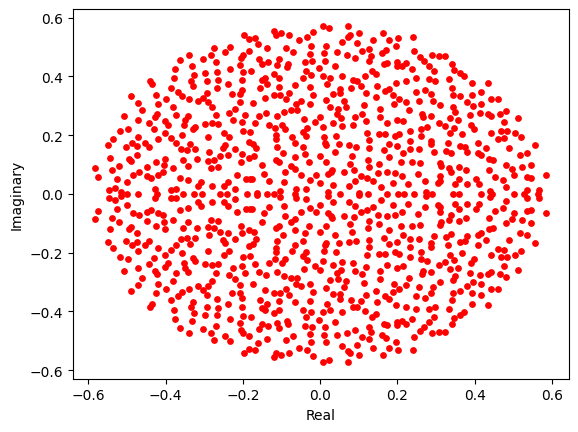

0.15530993040770236


In [35]:
input_dim = 1
autoencoder_layers = [32,64,128,256,512,1024,1024]
num_efunction = 1024
memory_steps = 32
model = KoopmanModel(input_dim, autoencoder_layers, num_efunction)
coef = [0.8,0.8,1,0.01,0.01,1.0e-10]

total_loss_temp = train_test(model, traj_expectation_degrees[1].reshape(-1,input_dim), memory_steps, coef, nepochs=20, lr=0.01)

for i in model.koopman_forward_layer.parameters():
    a = i
b = a.detach().numpy()
eigvals_temp = np.linalg.eigvals(b)

# extract real part
re = [ele.real for ele in eigvals_temp]
# extract imaginary part
im = [ele.imag for ele in eigvals_temp]

# plot the complex numbers
plt.scatter(re[:], im[:], s=15, c='red')
# plt.scatter(trueevalues[0], trueevalues[1], s=5, c='blue')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

print(avg_distance(eigvals_temp, real_eval_complex[1024]))

[120.21637570858002, 115.377988666296, 115.36628887057304, 115.35665125399828, 115.34842855483294, 115.34124117344618, 115.33451114594936, 115.32926588505507, 115.32463105022907, 115.32056237757206, 115.31696819514036, 115.31379065662622, 115.31097629666328, 115.30849305540323, 115.30628941953182, 115.30434263497591, 115.30261348187923, 115.30108298361301, 115.2997283115983, 115.29852429032326]
[17.181769490242004, 17.181260094046593, 17.181003160774708, 17.18086814135313, 17.180776089429855, 17.180723674595356, 17.18068142235279, 17.18065370619297, 17.180635564029217, 17.180623039603233, 17.18061339855194, 17.18060801923275, 17.180601313710213, 17.18059727549553, 17.180593490600586, 17.180590607225895, 17.180586732923985, 17.1805849224329, 17.180581584572792, 17.18058006465435]


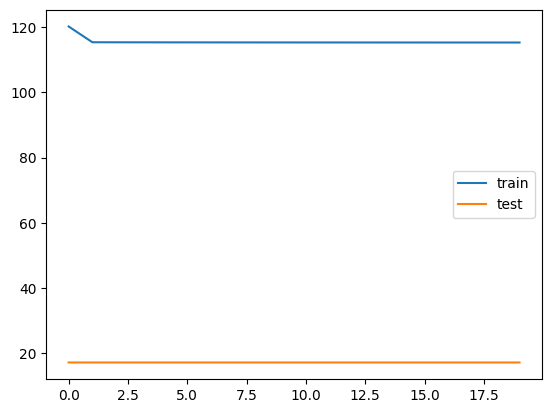

In [39]:
train_loss, test_loss = total_loss_temp
plt.plot(train_loss, label='train')
print(train_loss)
plt.plot(test_loss, label='test')
print(test_loss)
plt.legend()
plt.show()

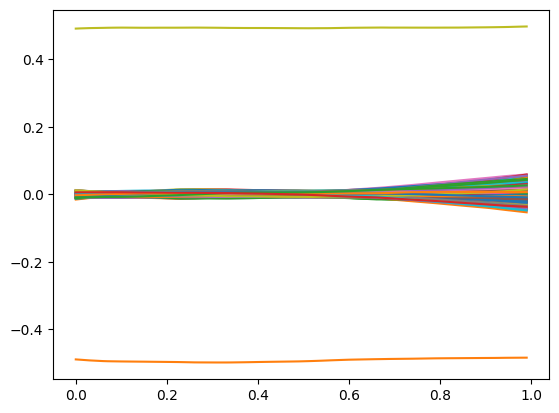

In [37]:
with torch.no_grad():
    x = np.arange(100,dtype='float32')/100
    x = x.reshape(-1,1)
    x = torch.tensor(x)
    # print(x.shape)
    gx, gx_pred, x_pred, x_auto = model(x)
    gx = gx.detach().numpy()
    x = x.detach().numpy()
    for i in range(1024):
        plt.plot(x,gx[:,i]*100)

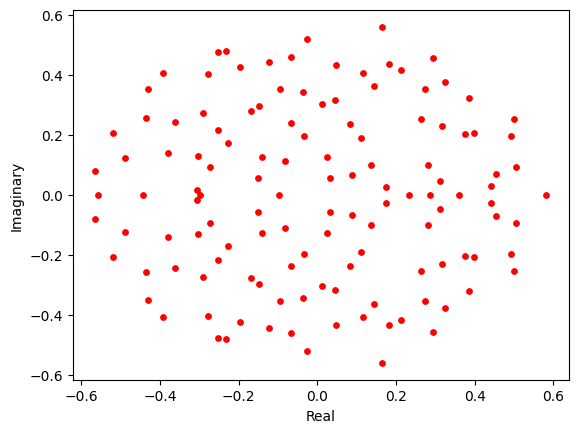

0.15206664246964402


In [40]:
input_dim = 1
autoencoder_layers = [32,64,128,128,128]
num_efunction = 128
memory_steps = 32
model = KoopmanModel(input_dim, autoencoder_layers, num_efunction)
coef = [0.8,0.8,1,0.01,0.01,1.0e-10]

total_loss_temp = train_test(model, traj_expectation_degrees[1].reshape(-1,input_dim), memory_steps, coef, nepochs=20, lr=0.01)

for i in model.koopman_forward_layer.parameters():
    a = i
b = a.detach().numpy()
eigvals_temp = np.linalg.eigvals(b)

# extract real part
re = [ele.real for ele in eigvals_temp]
# extract imaginary part
im = [ele.imag for ele in eigvals_temp]

# plot the complex numbers
plt.scatter(re[:], im[:], s=15, c='red')
# plt.scatter(trueevalues[0], trueevalues[1], s=5, c='blue')
plt.ylabel('Imaginary')
plt.xlabel('Real')
plt.show()

print(avg_distance(eigvals_temp, real_eval_complex[1024]))

[119.00366083532572, 115.43190697580576, 115.41079587489367, 115.39479617029428, 115.38179032504559, 115.37068603932858, 115.36122637987137, 115.35291474312544, 115.34554501622915, 115.3390773832798, 115.33328607678413, 115.3283172994852, 115.32390762865543, 115.32000336050987, 115.3146663159132, 115.31176516413689, 115.30924231559038, 115.30696247518063, 115.30496811121702, 115.30317436903715]
[17.18311434239149, 17.181756108999252, 17.181084282696247, 17.180866561830044, 17.18073244392872, 17.18064694851637, 17.180657386779785, 17.180602222681046, 17.180592387914658, 17.18058469891548, 17.180580742657185, 17.180582359433174, 17.180575892329216, 17.1805787011981, 17.18058755248785, 17.180586151778698, 17.18058893084526, 17.18060238659382, 17.18060577660799, 17.180600851774216]


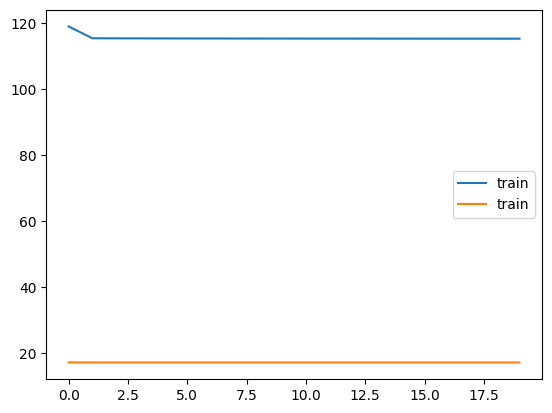

In [41]:
train_loss, test_loss = total_loss_temp
plt.plot(train_loss, label='train')
print(train_loss)
plt.plot(test_loss, label='train')
print(test_loss)
plt.legend()
plt.show()

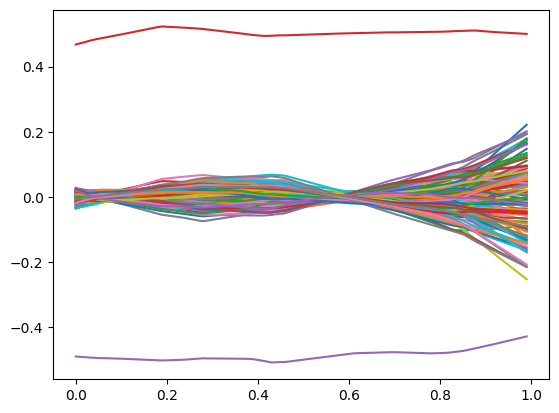

In [42]:
with torch.no_grad():
    x = np.arange(100,dtype='float32')/100
    x = x.reshape(-1,1)
    x = torch.tensor(x)
    # print(x.shape)
    gx, gx_pred, x_pred, x_auto = model(x)
    gx = gx.detach().numpy()
    x = x.detach().numpy()
    for i in range(128):
        plt.plot(x,gx[:,i]*100)